In [ ]:
#%pip install py3Dmol

In [ ]:
#%pip install rdkit

In [ ]:
#%pip install openmm

In [ ]:
#%pip install biopython

In [ ]:
#%pip install requests

In [ ]:
#INSTALAR EN TU ENTORNO VIRTUAL DESDE TERMINAL DE CONDA
#conda install -c conda-forge pdbfixer

In [ ]:
#%pip install prolif

In [ ]:
#%pip install nglview

In [ ]:
#PASO 0.1: DESCARGAR EL ARCHIVO .pdb REAL DEL OXA48 (EL ARCHIVO DADO NO CORRESPONDE AL MISMO)
import requests

# ID del PDB para OXA-48
pdb_id = "3HBR"  

# URL para descargar el archivo PDB
url = f"https://files.rcsb.org/download/{pdb_id}.pdb"

# Nombre del archivo de salida
output_file = f"bacterias/oxa48_real.pdb"

# Descargar el archivo
response = requests.get(url)
if response.status_code == 200:
    with open(output_file, 'w') as f:
        f.write(response.text)
    print(f"Archivo descargado: {output_file}")
else:
    print(f"Error al descargar el archivo. Código de estado: {response.status_code}")

Archivo descargado: bacterias/oxa48_real.pdb


In [ ]:
#PASO 0.2: REPARAR EL ARCHIVO .pdb DEL OXA48 REAL
from pdbfixer import PDBFixer
from openmm.app import PDBFile

# Carga el archivo PDB
fixer = PDBFixer(filename='bacterias/oxa48_real.pdb')

# Muestra las cadenas encontradas
chains = [chain.id for chain in fixer.topology.chains()]
print("Cadenas encontradas:", chains)

# Reemplaza residuos no estándar por estándar
fixer.findNonstandardResidues()
fixer.replaceNonstandardResidues()

# Elimina heteroátomos (puedes mantener agua si lo deseas)
fixer.removeHeterogens(keepWater=False)

# Detecta residuos y átomos faltantes
fixer.findMissingResidues()
fixer.findMissingAtoms()
print("Átomos faltantes:", fixer.missingAtoms)

# Agrega los átomos que faltan (excepto hidrógenos primero)
fixer.addMissingAtoms()

# Agrega hidrógenos ajustando el pH
fixer.addMissingHydrogens(pH=7.4)

# Guarda el archivo corregido
with open('bacterias/oxa48_fixed.pdb', 'w') as f:
    PDBFile.writeFile(fixer.topology, fixer.positions, f)

print("✅ Archivo corregido guardado como 'bacterias/oxa48_fixed.pdb'")

Cadenas encontradas: ['A', 'B', 'C', 'D', 'A', 'B', 'C', 'A', 'B', 'C', 'D']
Átomos faltantes: {<Residue 82 (ARG) of chain 0>: [<Atom 6 (CZ) of chain 0 residue 0 (ARG)>, <Atom 7 (NH1) of chain 0 residue 0 (ARG)>, <Atom 8 (NH2) of chain 0 residue 0 (ARG)>], <Residue 801 (ARG) of chain 3>: [<Atom 3 (CG) of chain 0 residue 0 (ARG)>, <Atom 4 (CD) of chain 0 residue 0 (ARG)>, <Atom 5 (NE) of chain 0 residue 0 (ARG)>, <Atom 6 (CZ) of chain 0 residue 0 (ARG)>, <Atom 7 (NH1) of chain 0 residue 0 (ARG)>, <Atom 8 (NH2) of chain 0 residue 0 (ARG)>]}
✅ Archivo corregido guardado como 'bacterias/oxa48_fixed.pdb'


In [ ]:
#PASO 1.1: VISUALIZAR EL GRAFICO 3D DEL NDM-1
import py3Dmol

def visualizar_pdb(path):
    with open(path, 'r') as f:
        pdb_data = f.read()

    view = py3Dmol.view(width=600, height=400)
    view.addModel(pdb_data, 'pdb')
    view.setStyle({'cartoon': {'color': 'spectrum'}})
    view.zoomTo()
    return view

# Visualiza NDM-1
visualizar_pdb("bacterias/ndm1_fixed.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 1.2: VISUALIZAR EL GRAFICO 3D DEL OXA48
visualizar_pdb("bacterias/oxa48_fixed.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

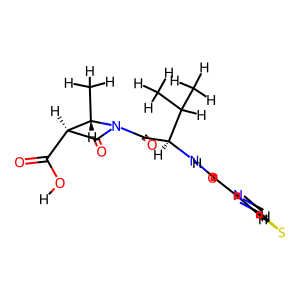

In [ ]:
#PASO 2.1.1: VISUALIZAR LA ESTRUCTURA 2D DEL IMIPENEM
from rdkit import Chem
from rdkit.Chem import AllChem, Draw
from rdkit.Chem.Draw import IPythonConsole
import py3Dmol

# SMILES de Imipenem desde PubChem
smiles_imipenem = "C[C@H]1[C@@H](C(=O)N1C(=O)[C@H](NC(=O)C2=CSC=N2)C(C)C)C(=O)O"

# Crear la molécula desde SMILES
mol = Chem.MolFromSmiles(smiles_imipenem)
mol = Chem.AddHs(mol)

# Generar conformación 3D y optimizar
AllChem.EmbedMolecule(mol)
AllChem.MMFFOptimizeMolecule(mol)

# Visualización 2D
Draw.MolToImage(mol)

In [ ]:
#PASO 2.1.2: GUARDAR EL ARCHIVO .pdb DEL IMIPENEM
from rdkit.Chem import rdmolfiles

# Guardar como archivo PDB
rdmolfiles.MolToPDBFile(mol, "imipenem.pdb")

# Visualizar en 3D
def visualizar_pdb(path):
    with open(path, 'r') as f:
        pdb_data = f.read()
    view = py3Dmol.view(width=500, height=400)
    view.addModel(pdb_data, 'pdb')
    view.setStyle({'stick': {}})
    view.zoomTo()
    return view

visualizar_pdb("imipenem.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

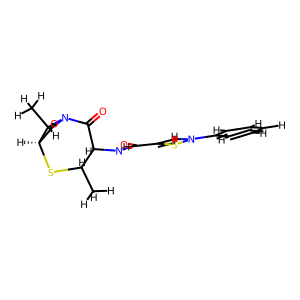

In [ ]:
#PASO 2.2.1: VISUALIZAR LA ESTRUCTURA 2D DEL MEROPENEM
# SMILES de Meropenem
smiles_meropenem = "CC1[C@H]2C(=O)N1C(=O)[C@H](NC(=O)C3=CN(C4=CC=CC=C4)S3)C(C)S2"

# Crear la molécula
meropenem = Chem.MolFromSmiles(smiles_meropenem)
meropenem = Chem.AddHs(meropenem)

# Generar conformación 3D y optimizarla
AllChem.EmbedMolecule(meropenem)
AllChem.MMFFOptimizeMolecule(meropenem)

# Mostrar en 2D
Draw.MolToImage(meropenem)

In [ ]:
#PASO 2.2.2: GUARDAR EL ARCHIVO .pdb DEL MEROPENEM
# Guardar como archivo PDB
rdmolfiles.MolToPDBFile(meropenem, "meropenem.pdb")

visualizar_pdb("meropenem.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 3.1.1: PREPARAR EL NDM-1 PARA LA SIMULACION Y GUARDARLO EN UN ARCHIVO .pdb
from openmm.app import *
from openmm import *
from openmm.unit import *

# Cargar la enzima NDM-1
pdb_ndm1 = PDBFile("bacterias/ndm1_fixed.pdb")

# Cargar campos de fuerza
forcefield = ForceField('amber14-all.xml', 'amber14/tip3pfb.xml')

# Agregar hidrógenos (necesario para simular)
modeller = Modeller(pdb_ndm1.topology, pdb_ndm1.positions)
modeller.addHydrogens(forcefield)

# (Opcional) Agregar caja de agua:
# modeller.addSolvent(forcefield, model='tip3p', padding=1.0*nanometers)

# Guardar versión con hidrógenos
with open("ndm1_prepared.pdb", "w") as out_pdb:
    PDBFile.writeFile(modeller.topology, modeller.positions, out_pdb)

In [ ]:
#PASO 3.1.2: VISUALIZAR EL NDM-1 LISTO PARA LA SIMULACION
visualizar_pdb("ndm1_prepared.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 3.2.1: PREPARAR EL OXA48 PARA LA SIMULACION Y GUARDARLO EN UN ARCHIVO .pdb
from openmm.app import *
from openmm import *
from openmm.unit import *

pdb_oxa48 = PDBFile("bacterias/oxa48_fixed.pdb")  # EDO eliminado

forcefield = ForceField('amber14-all.xml', 'amber14/tip3pfb.xml')

modeller_oxa = Modeller(pdb_oxa48.topology, pdb_oxa48.positions)
modeller_oxa.addHydrogens(forcefield)

with open("oxa48_prepared.pdb", "w") as out_pdb:
    PDBFile.writeFile(modeller_oxa.topology, modeller_oxa.positions, out_pdb)

In [ ]:
#PASO 3.2.2: VISUALIZAR EL OXA48 LISTO PARA LA SIMULACION
visualizar_pdb("oxa48_prepared.pdb")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 4: GENERAR CONFORMACIONES 3D DE LOS ANTIBIOTICOS
from rdkit import Chem
from rdkit.Chem import AllChem, Draw
import py3Dmol

# SMILES de los antibióticos
smiles_imipenem = "CC1C(NC(C1C(=O)NCC2=CN=CS2)=O)[C@@H]3C=CC(=O)N3"
smiles_meropenem = "CC1[C@H](NC(C1C(=O)NCC2=CN=CS2)=O)[C@@H]3C=CC(=O)N3C(C)C"

# Cargar y generar conformaciones 3D
mol_imipenem = Chem.MolFromSmiles(smiles_imipenem)
mol_imipenem = Chem.AddHs(mol_imipenem)
AllChem.EmbedMolecule(mol_imipenem)
AllChem.UFFOptimizeMolecule(mol_imipenem)

mol_meropenem = Chem.MolFromSmiles(smiles_meropenem)
mol_meropenem = Chem.AddHs(mol_meropenem)
AllChem.EmbedMolecule(mol_meropenem)
AllChem.UFFOptimizeMolecule(mol_meropenem)

1

In [ ]:
#PASO 5.0.0: GENERAR GRAFICOS DE LAS ENZIMAS CON LOS ANTIBIOTICOS
def mostrar_con_sitio_activo(pdb_path, mol, antib_nombre="Antibiótico", ion_nombre="ZN"):
    import py3Dmol
    from rdkit import Chem

    block = Chem.MolToPDBBlock(mol)
    viewer = py3Dmol.view(width=800, height=500)

    # Cargar enzima (modelo 0)
    with open(pdb_path, "r") as f:
        pdb_data = f.read()
        viewer.addModel(pdb_data, "pdb")
    viewer.setStyle({'model': 0}, {"cartoon": {'color': 'spectrum'}})

    # Resaltar el ion del sitio activo (ej. ZN)
    viewer.addStyle({'model': 0, 'resn': ion_nombre}, {"sphere": {
        'radius': 1.2,
        'color': 'yellow'
    }})

    # Cargar antibiótico (modelo 1)
    viewer.addModel(block, "pdb")
    viewer.setStyle({'model': 1}, {
        "stick": {'radius': 0.25, 'colorscheme': 'magentaCarbon'},
        "sphere": {'radius': 0.4, 'colorscheme': 'magentaCarbon'}
    })

    viewer.zoomTo()
    return viewer

In [ ]:
#PASO 5.1.1: GENERAR GRAFICO DE NDM-1 CON IMIPENEM
mostrar_con_sitio_activo("bacterias/ndm1_fixed.pdb", mol_imipenem, "Imipenem", ion_nombre="ZN")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 5.1.2: GENERAR GRAFICO DE NDM-1 CON MEROPENEM
mostrar_con_sitio_activo("bacterias/ndm1_fixed.pdb", mol_meropenem, "Meropenem", ion_nombre="ZN")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 5.2.1: GENERAR GRAFICO DE OXA48 CON IMIPENEM
mostrar_con_sitio_activo("bacterias/oxa48_fixed.pdb", mol_imipenem, "Imipenem", ion_nombre="ZN")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [ ]:
#PASO 5.2.2: GENERAR GRAFICO DE OXA48 CON MEROPENEM
mostrar_con_sitio_activo("bacterias/oxa48_fixed.pdb", mol_meropenem, "Meropenem", ion_nombre="ZN")

3Dmol.js failed to load for some reason. Please check your browser console for error messages.

In [64]:
from openmm.app import *
from openmm import *
from openmm.unit import *

# Cargar enzima y antibiótico
enzyme = PDBFile('ndm1_prepared.pdb')      # o 'oxa48_prepared.pdb'
ligand = PDBFile('imipenem.pdb')           # o 'meropenem.pdb'

# Usamos Modeller para combinarlos correctamente
modeller = Modeller(enzyme.topology, enzyme.positions)
modeller.add(ligand.topology, ligand.positions)

# Guardar el complejo unido
with open('complex.pdb', 'w') as f:
    PDBFile.writeFile(modeller.topology, modeller.positions, f)


In [70]:
from openmm.app import *
from openmm import *
from openmm.unit import *

# --- Cargar el complejo enzima-antibiótico ---
pdb = PDBFile("complex.pdb")

# --- Campo de fuerza AMBER ---
forcefield = ForceField('amber14-all.xml', 'amber14/tip3pfb.xml')

# --- Modeller: agregar H y solvatación ---
modeller = Modeller(pdb.topology, pdb.positions)
modeller.addHydrogens(forcefield)
modeller.addSolvent(forcefield, model='tip3p', padding=1.0*nanometers)

# --- Crear sistema ---
system = forcefield.createSystem(
    modeller.topology,
    nonbondedMethod=PME,
    nonbondedCutoff=1.0*nanometers,
    constraints=HBonds,
    rigidWater=True
)

# --- Guardar sistema solvado ---
with open("solvated.pdb", "w") as f:
    PDBFile.writeFile(modeller.topology, modeller.positions, f)

print("✅ Sistema solvado completo guardado como 'solvated.pdb'")


ValueError: No template found for residue 1824 (UNL).  This might mean your input topology is missing some atoms or bonds, or possibly that you are using the wrong force field.  For more information, see https://github.com/openmm/openmm/wiki/Frequently-Asked-Questions#template